In [192]:
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.offline as py
import plotly.graph_objs as go
import matplotlib.patches as mpatches
import seaborn as sns
import numpy as np
plt.style.use('fivethirtyeight')
from matplotlib import animation,rc
import folium
import folium.plugins
import io
import base64
from IPython.display import HTML, display
import warnings
import codecs
from pandas import DataFrame
from ipywidgets import interact
from wordcloud import WordCloud
from scipy import signal
warnings.filterwarnings('ignore')

In [193]:
#data import
#first 5 data info
data = pd.read_csv(r'C:\Users\Admin\Downloads\archive\globalterrorismdb_0718dist.csv', engine='python')
data.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [194]:
#display the data info
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [195]:
#describe data
data.describe(include='all')

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
count,1.816910e+05,181691.000000,181691.000000,181691.000000,9239,181691.000000,2220,181691.000000,181691,181691.000000,...,28289,115500,76933,43516,181691,181691.000000,181691.000000,181691.000000,181691.000000,25038
unique,NaN,NaN,NaN,NaN,2244,NaN,1859,NaN,205,NaN,...,15429,83988,62263,36090,26,NaN,NaN,NaN,NaN,14306
top,NaN,NaN,NaN,NaN,"September 18-24, 2016",NaN,8/4/1998,NaN,Iraq,NaN,...,Casualty numbers for this incident conflict ac...,Committee on Government Operations United Stat...,"Christopher Hewitt, ""Political Violence and Te...","Christopher Hewitt, ""Political Violence and Te...",START Primary Collection,NaN,NaN,NaN,NaN,"201612010023, 201612010024, 201612010025, 2016..."
freq,NaN,NaN,NaN,NaN,101,NaN,18,NaN,24636,NaN,...,1607,205,134,139,78002,NaN,NaN,NaN,NaN,80
mean,2.002705e+11,2002.638997,6.467277,15.505644,NaN,0.045346,NaN,131.968501,NaN,7.160938,...,NaN,NaN,NaN,NaN,NaN,-4.543731,-4.464398,0.090010,-3.945952,NaN
std,1.325957e+09,13.259430,3.388303,8.814045,NaN,0.208063,NaN,112.414535,NaN,2.933408,...,NaN,NaN,NaN,NaN,NaN,4.543547,4.637152,0.568457,4.691325,NaN
min,1.970000e+11,1970.000000,0.000000,0.000000,NaN,0.000000,NaN,4.000000,NaN,1.000000,...,NaN,NaN,NaN,NaN,NaN,-9.000000,-9.000000,-9.000000,-9.000000,NaN
25%,1.991021e+11,1991.000000,4.000000,8.000000,NaN,0.000000,NaN,78.000000,NaN,5.000000,...,NaN,NaN,NaN,NaN,NaN,-9.000000,-9.000000,0.000000,-9.000000,NaN
50%,2.009022e+11,2009.000000,6.000000,15.000000,NaN,0.000000,NaN,98.000000,NaN,6.000000,...,NaN,NaN,NaN,NaN,NaN,-9.000000,-9.000000,0.000000,0.000000,NaN
75%,2.014081e+11,2014.000000,9.000000,23.000000,NaN,0.000000,NaN,160.000000,NaN,10.000000,...,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,NaN


In [196]:
#to check the values of data
data.shape

(181691, 135)

In [197]:
#to check the columns name in data
data.columns.values

array(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region', 'region_txt',
       'provstate', 'city', 'latitude', 'longitude', 'specificity',
       'vicinity', 'location', 'summary', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'alternative', 'alternative_txt', 'multiple',
       'success', 'suicide', 'attacktype1', 'attacktype1_txt',
       'attacktype2', 'attacktype2_txt', 'attacktype3', 'attacktype3_txt',
       'targtype1', 'targtype1_txt', 'targsubtype1', 'targsubtype1_txt',
       'corp1', 'target1', 'natlty1', 'natlty1_txt', 'targtype2',
       'targtype2_txt', 'targsubtype2', 'targsubtype2_txt', 'corp2',
       'target2', 'natlty2', 'natlty2_txt', 'targtype3', 'targtype3_txt',
       'targsubtype3', 'targsubtype3_txt', 'corp3', 'target3', 'natlty3',
       'natlty3_txt', 'gname', 'gsubname', 'gname2', 'gsubname2',
       'gname3', 'gsubname3', 'motive', 'guncertain1', 'guncertain2',
       'guncertain3', 'in

In [198]:
#data cleaning
#clean unnecessary data
#keep the important columns and exclude the irrelevant ones
data = data[["iyear", "imonth", "iday", "country", "country_txt", "region_txt", "city", "success","suicide", "attacktype1_txt", "nkill", "nwound",  "targtype1_txt", "latitude", "gname", "longitude", "targsubtype1_txt", "target1", "weaptype1_txt", "weapdetail"]]

In [199]:
#check the null values in necessary columns
data.isnull().sum()

iyear                   0
imonth                  0
iday                    0
country                 0
country_txt             0
region_txt              0
city                  434
success                 0
suicide                 0
attacktype1_txt         0
nkill               10313
nwound              16311
targtype1_txt           0
latitude             4556
gname                   0
longitude            4557
targsubtype1_txt    10373
target1               636
weaptype1_txt           0
weapdetail          67670
dtype: int64

In [200]:
#manipulating the the nan values in columns
data["city"].fillna("Unknown", inplace = True)
data["nkill"].fillna(0, inplace = True)
data["nwound"].fillna(0, inplace = True)
data["target1"].fillna("Unknown", inplace = True)
data["latitude"].fillna("Unidentified", inplace = True)
data["longitude"].fillna("Unidentified", inplace = True)
data["targsubtype1_txt"].fillna("Unknown", inplace = True)
data["weapdetail"].fillna("Unknown", inplace = True)

In [201]:
#check the values after manipulating the nan values
data.isnull().sum()

iyear               0
imonth              0
iday                0
country             0
country_txt         0
region_txt          0
city                0
success             0
suicide             0
attacktype1_txt     0
nkill               0
nwound              0
targtype1_txt       0
latitude            0
gname               0
longitude           0
targsubtype1_txt    0
target1             0
weaptype1_txt       0
weapdetail          0
dtype: int64

In [202]:
#display the necessary columns after cleaning
data.head(10)

,iyear,imonth,iday,country,country_txt,region_txt,city,success,suicide,attacktype1_txt,nkill,nwound,targtype1_txt,latitude,gname,longitude,targsubtype1_txt,target1,weaptype1_txt,weapdetail
0,1970,7,2,58,Dominican Republic,Central America & Caribbean,Santo Domingo,1,0,Assassination,1.0,0.0,Private Citizens & Property,18.4568,MANO-D,-69.9512,Named Civilian,Julio Guzman,Unknown,Unknown
1,1970,0,0,130,Mexico,North America,Mexico city,1,0,Hostage Taking (Kidnapping),0.0,0.0,Government (Diplomatic),19.3719,23rd of September Communist League,-99.0866,"Diplomatic Personnel (outside of embassy, cons...","Nadine Chaval, daughter",Unknown,Unknown
2,1970,1,0,160,Philippines,Southeast Asia,Unknown,1,0,Assassination,1.0,0.0,Journalists & Media,15.4786,Unknown,120.6,Radio Journalist/Staff/Facility,Employee,Unknown,Unknown
3,1970,1,0,78,Greece,Western Europe,Athens,1,0,Bombing/Explosion,0.0,0.0,Government (Diplomatic),37.9975,Unknown,23.7627,Embassy/Consulate,U.S. Embassy,Explosives,Explosive
4,1970,1,0,101,Japan,East Asia,Fukouka,1,0,Facility/Infrastructure Attack,0.0,0.0,Government (Diplomatic),33.5804,Unknown,130.396,Embassy/Consulate,U.S. Consulate,Incendiary,Incendiary
5,1970,1,1,217,United States,North America,Cairo,1,0,Armed Assault,0.0,0.0,Police,37.0051,Black Nationalists,-89.1763,"Police Building (headquarters, station, school)",Cairo Police Headquarters,Firearms,Several gunshots were fired.
6,1970,1,2,218,Uruguay,South America,Montevideo,0,0,Assassination,0.0,0.0,Police,-34.8912,Tupamaros (Uruguay),-56.1872,Police Security Forces/Officers,Juan Maria de Lucah/Chief of Directorate of in...,Firearms,Automatic firearm
7,1970,1,2,217,United States,North America,Oakland,1,0,Bombing/Explosion,0.0,0.0,Utilities,37.7919,Unknown,-122.226,Electricity,Edes Substation,Explosives,Unknown
8,1970,1,2,217,United States,North America,Madison,1,0,Facility/Infrastructure Attack,0.0,0.0,Military,43.0766,New Year's Gang,-89.4125,Military Recruiting Station/Academy,"R.O.T.C. offices at University of Wisconsin, M...",Incendiary,Firebomb consisting of gasoline
9,1970,1,3,217,United States,North America,Madison,1,0,Facility/Infrastructure Attack,0.0,0.0,Government (General),43.0729,New Year's Gang,-89.3867,Government Building/Facility/Office,Selective Service Headquarters in Madison Wisc...,Incendiary,Poured gasoline on the floor and lit it with a...


In [203]:
#data standardization
#rename the column names to appropriate names
data.rename(columns = {'iyear' : 'Year', "imonth" : "Month", "iday" : "Day", "country" : "CountryNo",
                     "country_txt" : "Country", "region_txt" : "Region", "city" : "City", 'success' : 'Success', 'suicide' : 'Suicide',
                     "attacktype1_txt" : "AttackType", "targtype1_txt" : "TargetType","latitude" : "Latitude", "gname" : "GroupName",
                     "longitude":"Longitude","targsubtype1_txt" : "TargetSubType", "target1" : "Target", "nkill" : "NoOfKills", 'nwound':'NoOfWounded',
                     "weaptype1_txt" : "WeaponType", "weapdetail" : "WeaponDetail"}, inplace = True)

In [204]:
#display data after rename
data.head()

,Year,Month,Day,CountryNo,Country,Region,City,Success,Suicide,AttackType,NoOfKills,NoOfWounded,TargetType,Latitude,GroupName,Longitude,TargetSubType,Target,WeaponType,WeaponDetail
0,1970,7,2,58,Dominican Republic,Central America & Caribbean,Santo Domingo,1,0,Assassination,1.0,0.0,Private Citizens & Property,18.4568,MANO-D,-69.9512,Named Civilian,Julio Guzman,Unknown,Unknown
1,1970,0,0,130,Mexico,North America,Mexico city,1,0,Hostage Taking (Kidnapping),0.0,0.0,Government (Diplomatic),19.3719,23rd of September Communist League,-99.0866,"Diplomatic Personnel (outside of embassy, cons...","Nadine Chaval, daughter",Unknown,Unknown
2,1970,1,0,160,Philippines,Southeast Asia,Unknown,1,0,Assassination,1.0,0.0,Journalists & Media,15.4786,Unknown,120.6,Radio Journalist/Staff/Facility,Employee,Unknown,Unknown
3,1970,1,0,78,Greece,Western Europe,Athens,1,0,Bombing/Explosion,0.0,0.0,Government (Diplomatic),37.9975,Unknown,23.7627,Embassy/Consulate,U.S. Embassy,Explosives,Explosive
4,1970,1,0,101,Japan,East Asia,Fukouka,1,0,Facility/Infrastructure Attack,0.0,0.0,Government (Diplomatic),33.5804,Unknown,130.396,Embassy/Consulate,U.S. Consulate,Incendiary,Incendiary


In [205]:
#to create new column named Casualities that totaled the number of victims 
data['Casualities'] = data.NoOfKills + data.NoOfWounded

In [206]:
#to combine date column based on day/month/year
cols=["Day","Month","Year"]
data['Date'] = data[cols].apply(lambda x: '-'.join(x.values.astype(str)), axis="columns")

In [207]:
#to rearrange the data accordingly and display last 5 data
data=data[['Year','Month','Day','Date','CountryNo','Country','Region','City', 
       'Latitude','Longitude','AttackType','Success','Suicide','NoOfKills','NoOfWounded','Casualities','TargetType','TargetSubType','Target', 'GroupName','WeaponType', 'WeaponDetail']]
data.tail()

,Year,Month,Day,Date,CountryNo,Country,Region,City,Latitude,Longitude,...,Suicide,NoOfKills,NoOfWounded,Casualities,TargetType,TargetSubType,Target,GroupName,WeaponType,WeaponDetail
181686,2017,12,31,31-12-2017,182,Somalia,Sub-Saharan Africa,Ceelka Geelow,2.35967,45.385,...,0,1.0,2.0,3.0,Military,Military Checkpoint,Checkpoint,Al-Shabaab,Firearms,Unknown
181687,2017,12,31,31-12-2017,200,Syria,Middle East & North Africa,Jableh,35.4073,35.9427,...,0,2.0,7.0,9.0,Military,Military Barracks/Base/Headquarters/Checkpost,Hmeymim Air Base,Muslim extremists,Explosives,Mortars were used in the attack.
181688,2017,12,31,31-12-2017,160,Philippines,Southeast Asia,Kubentog,6.90074,124.438,...,0,0.0,0.0,0.0,Private Citizens & Property,House/Apartment/Residence,Houses,Bangsamoro Islamic Freedom Movement (BIFM),Incendiary,Unknown
181689,2017,12,31,31-12-2017,92,India,South Asia,Imphal,24.7983,93.9404,...,0,0.0,0.0,0.0,Government (General),Government Building/Facility/Office,Office,Unknown,Explosives,A thrown grenade was used in the attack.
181690,2017,12,31,31-12-2017,160,Philippines,Southeast Asia,Cotabato City,7.20959,124.242,...,0,0.0,0.0,0.0,Unknown,Unknown,Unknown,Unknown,Explosives,An explosive device containing a detonating co...


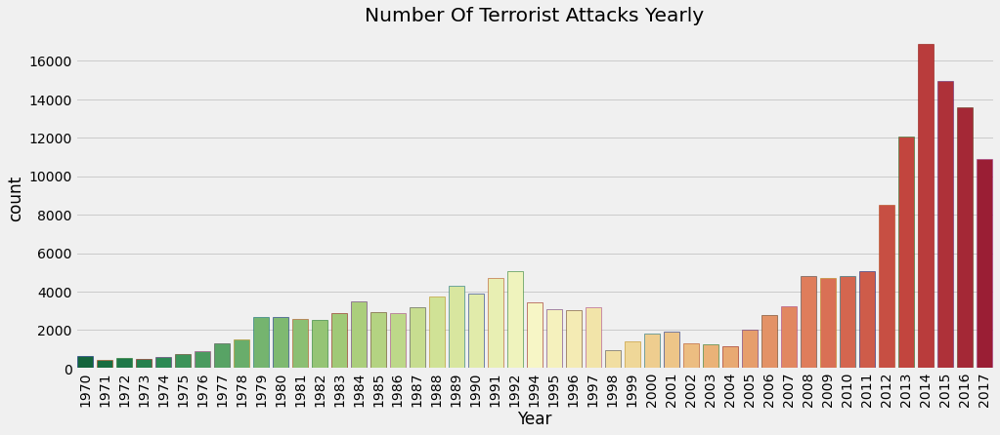

In [208]:
#data visualization
#to see the number of attacks yearly
plt.subplots(figsize=(15,6))
sns.countplot('Year',data=data,palette='RdYlGn_r',edgecolor=sns.color_palette('dark',10))
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Attacks Yearly')
plt.show()

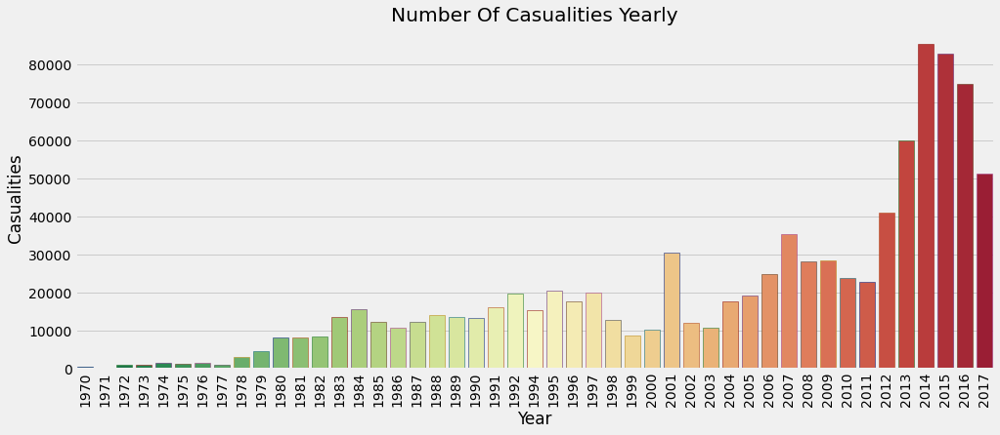

In [209]:
#to see the number of victims yearly
plt.subplots(figsize=(15,6))
year_cas = data.groupby('Year').Casualities.sum().to_frame().reset_index()
year_cas.columns = ['Year','Casualities']
sns.barplot(x=year_cas.Year, y=year_cas.Casualities, palette='RdYlGn_r',edgecolor=sns.color_palette('dark',10))
plt.xticks(rotation=90)
plt.title('Number Of Casualities Yearly')
plt.show()

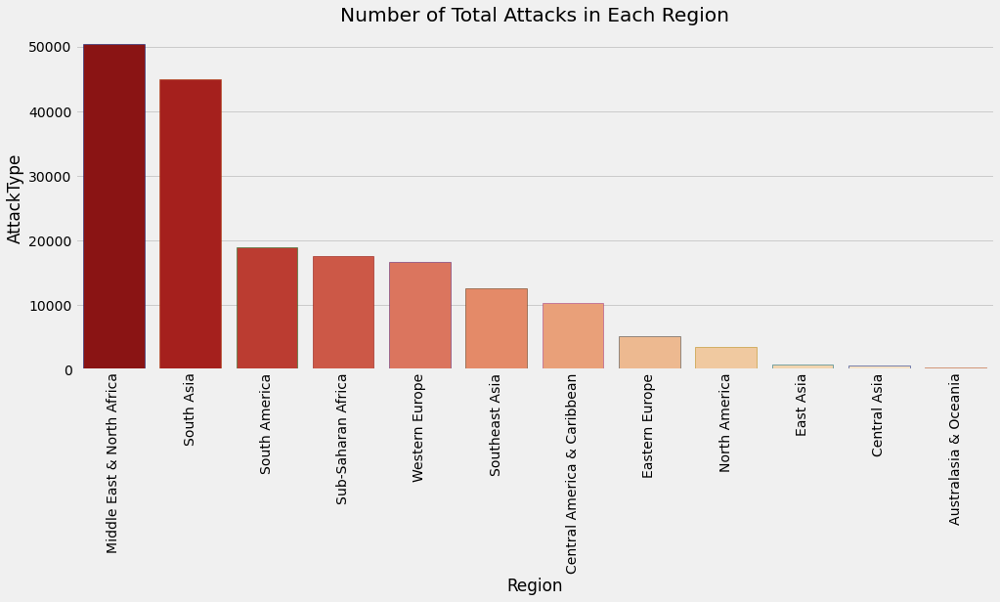

In [210]:
#to display the number of total attacks according to region
region_attacks = data.Region.value_counts().to_frame().reset_index()
region_attacks.columns = ['Region', 'AttackType']
plt.subplots(figsize=(15,6))
sns.barplot(x=region_attacks.Region, y=region_attacks['AttackType'], palette='OrRd_r', edgecolor=sns.color_palette('dark',10))
plt.xticks(rotation=90)
plt.title('Number of Total Attacks in Each Region')
plt.show()

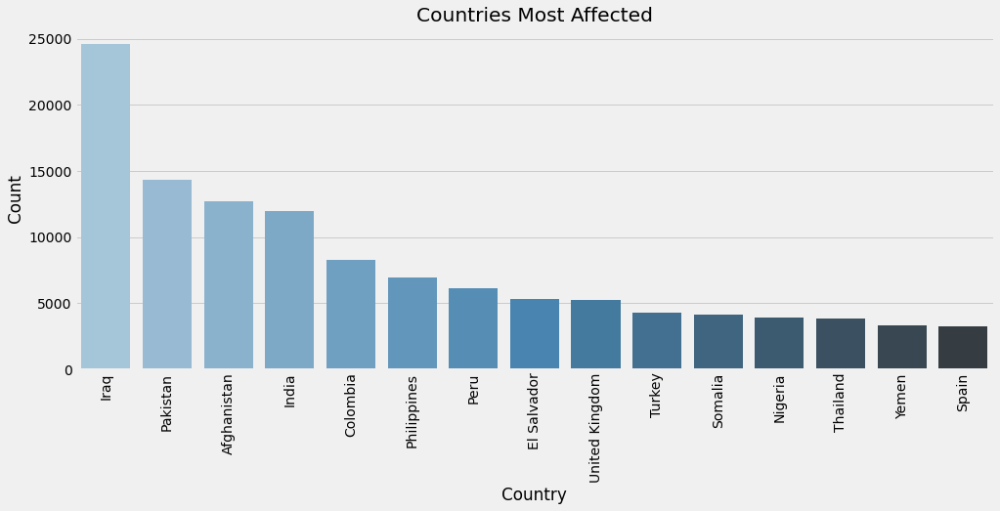

In [211]:
#to show the top countries that are most affected
plt.subplots(figsize=(15,6))
sns.barplot(data['Country'].value_counts()[:15].index,data['Country'].value_counts()[:15].values,palette='Blues_d')
plt.title('Countries Most Affected')
plt.xlabel('Country')
plt.ylabel('Count')
plt.xticks(rotation= 90)
plt.show()

Text(0.5, 1.0, 'Success vs Failure')

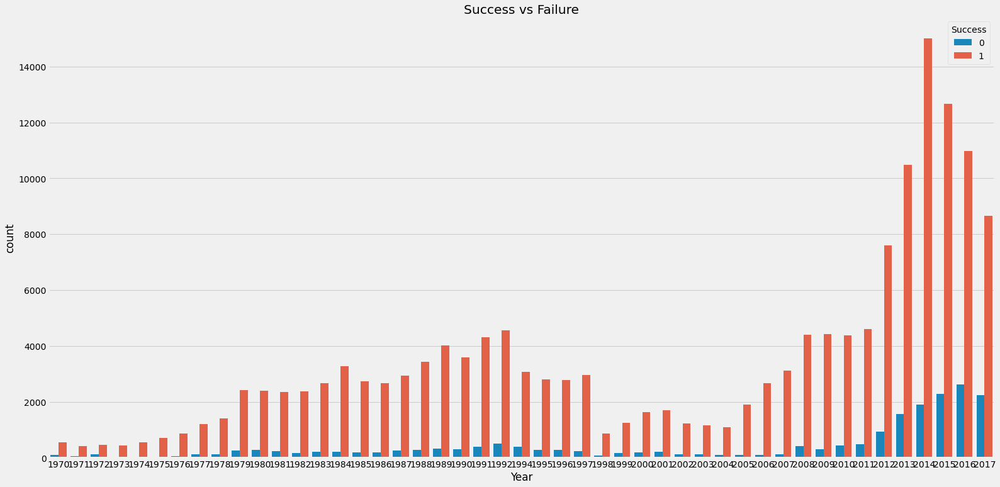

In [212]:
#to display the successful attacks per year
#success = 1 failure = 0
plt.figure(figsize=(24,12))
sns.countplot(x = "Year", hue = "Success", data = data)
plt.title("Success vs Failure")

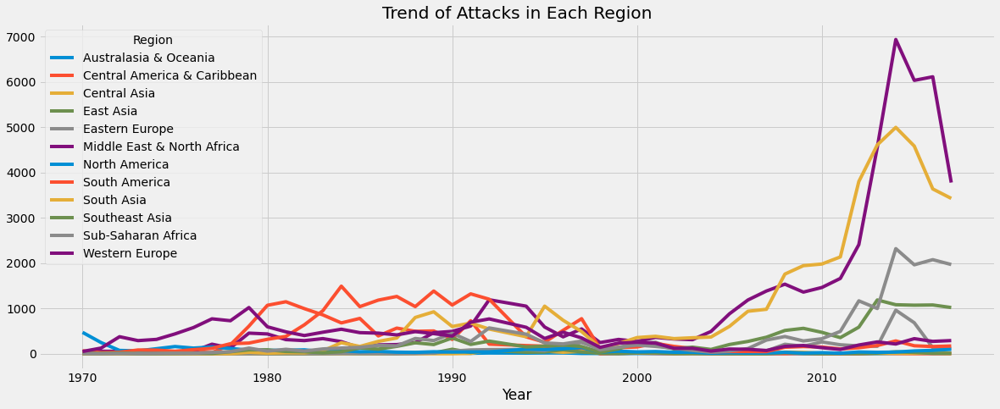

In [213]:
#to display the trend of attacks according to region
plt.rcParams['figure.figsize']=18,7
terror_area=pd.crosstab(data.Year,data.Region)
terror_area.plot()
plt.title('Trend of Attacks in Each Region')
plt.show()

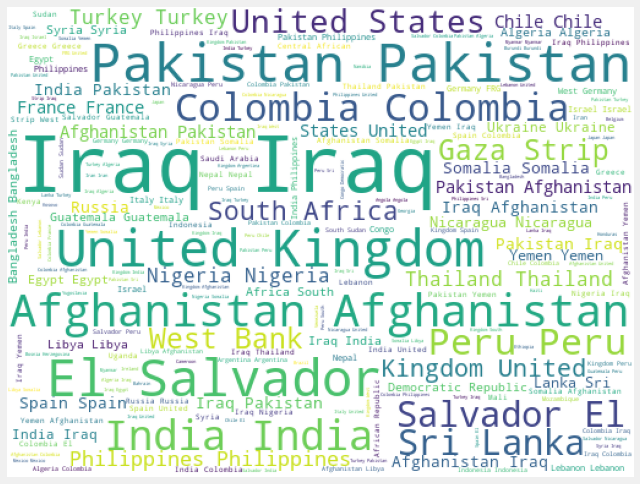

In [214]:
#visualization of wordcloud
cities = data.Country.dropna(False)
plt.subplots(figsize=(10,10))
wordcloud = WordCloud(background_color = 'white',
                     width = 512,
                     height = 384).generate(' '.join(cities))
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

In [215]:
#list of countries that are often targeted with numbers of attacks
print(f"The highest terrorist attacks were commited in {data.Country.value_counts().index[0]} with a number of {data.Country.value_counts().max()} attacks")

print('It is followed by another 4 countries:')
for i in range(1,5):
    print(f"{i+1}. {data.Country.value_counts().index[i]} with {data.Country.value_counts()[i]} attacks")

The highest terrorist attacks were commited in Iraq with a number of 24636 attacks
It is followed by another 4 countries:
2. Pakistan with 14368 attacks
3. Afghanistan with 12731 attacks
4. India with 11960 attacks
5. Colombia with 8306 attacks


In [216]:
#to display the percentage of people killed with specific weapon
px.pie(data, names = "AttackType", values = "NoOfKills", title = "Percentage of Killed According to Weapon ")

In [217]:
#to display the percentage of wounded victims according to weapons used
px.pie(data, names = "AttackType", values = "NoOfWounded", title = "Percentage of Wounded According to Weapon")

In [218]:
#to display the percentage of killed victims based on the target
px.pie(data, names = "TargetType", values = "NoOfKills", title = "Percentage of Killed According Target")

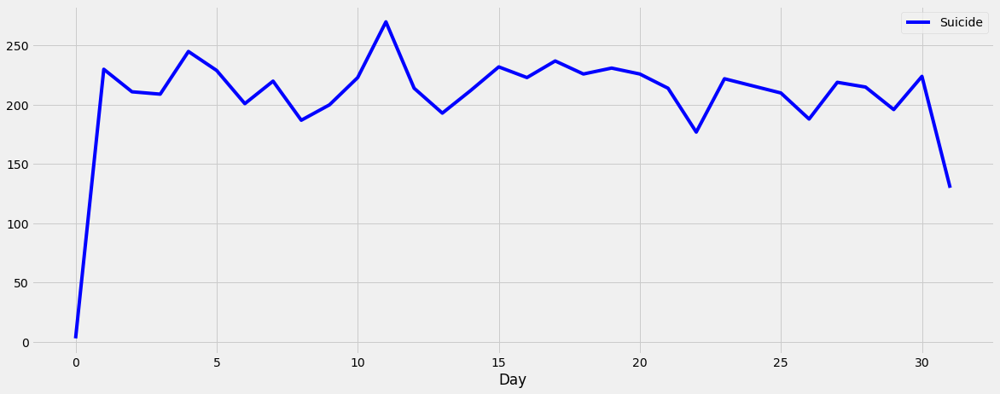

In [219]:
#to display the suicide attacks daily
suicides_by_month = data[["Day","Suicide"]].groupby("Day").aggregate(np.sum)
suicides_by_month.plot(color = 'b');

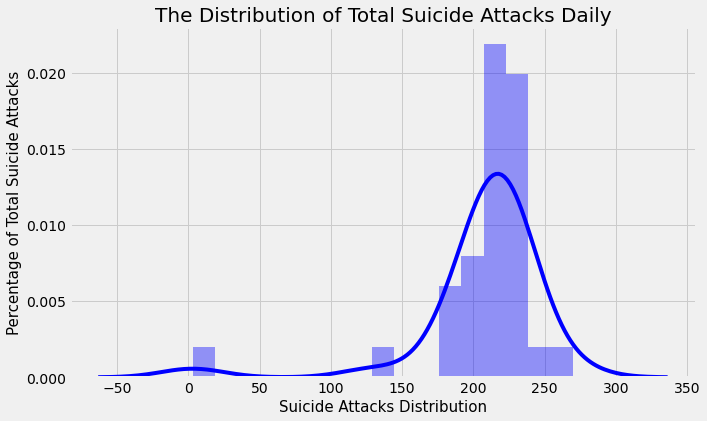

In [220]:
#to display the distribution of total suicide attacks daily
plt.figure(figsize=(10,6))
fig = sns.distplot(data[["Day","Suicide"]].groupby("Day").aggregate(np.sum), color = 'b')
fig.set_xlabel("Suicide Attacks Distribution",size=15)
fig.set_ylabel("Percentage of Total Suicide Attacks",size=15)
plt.title('The Distribution of Total Suicide Attacks Daily',size = 20)
plt.show()

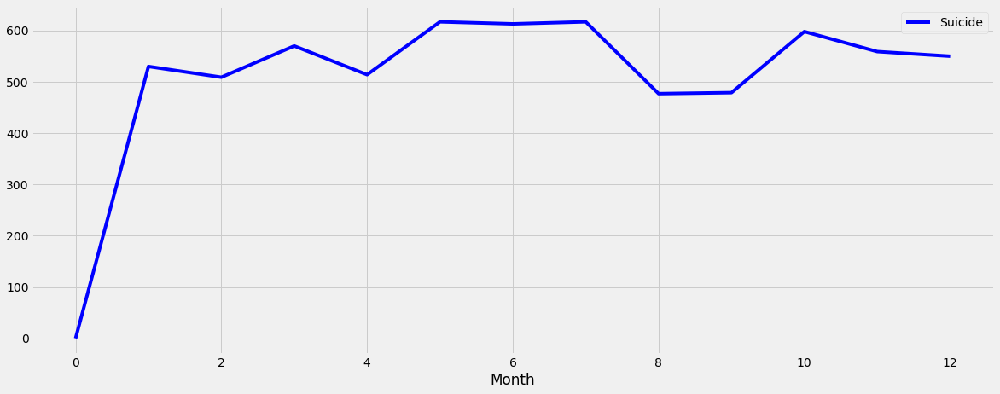

In [221]:
#suicide attack monthly
suicides_by_month = data[["Month","Suicide"]].groupby("Month").aggregate(np.sum)
suicides_by_month.plot(color = 'b');

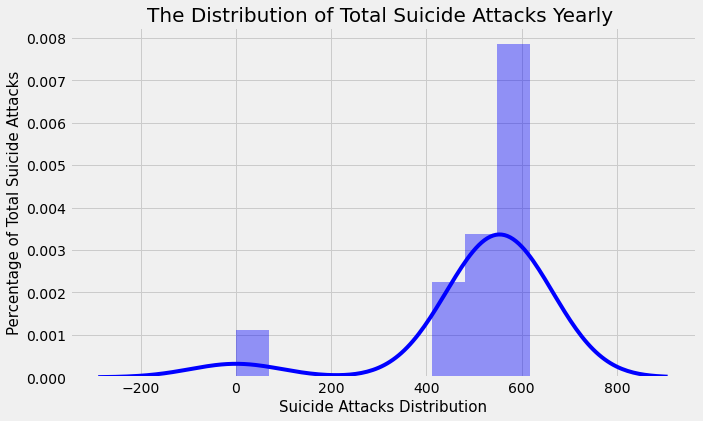

In [222]:
#to show the distribution of total suicide attacks accrording to year
plt.figure(figsize=(10,6))
fig = sns.distplot(data[["Month","Suicide"]].groupby("Month").aggregate(np.sum), color = 'b')
fig.set_xlabel("Suicide Attacks Distribution",size=15)
fig.set_ylabel("Percentage of Total Suicide Attacks",size=15)
plt.title('The Distribution of Total Suicide Attacks Yearly ',size = 20)
plt.show()

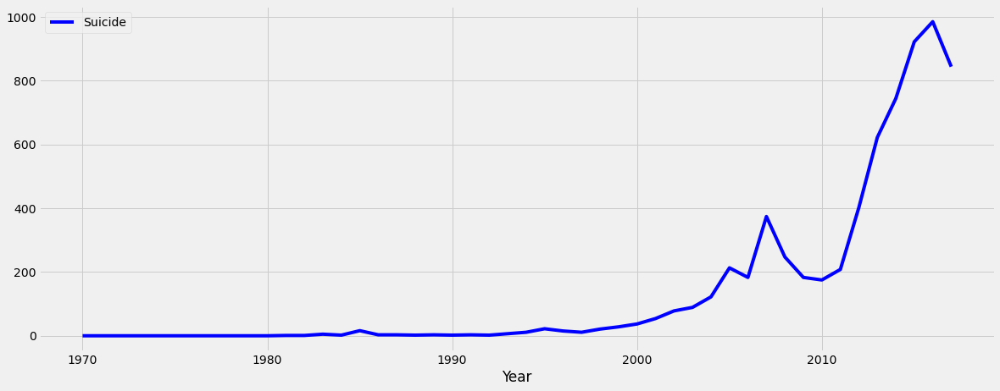

In [223]:
#to show the suicide attacks yearly
suicides_by_year = data[["Year","Suicide"]].groupby("Year").aggregate(np.sum)
suicides_by_year.plot(color = 'b');

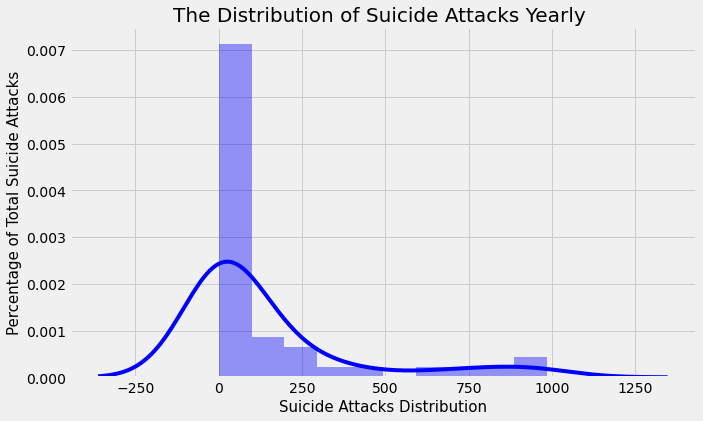

In [224]:
#to display the distribution of suicide attacks each year
plt.figure(figsize=(10,6))
fig = sns.distplot(data[["Year","Suicide"]].groupby("Year").aggregate(np.sum), color = 'b')
fig.set_xlabel("Suicide Attacks Distribution",size=15)
fig.set_ylabel("Percentage of Total Suicide Attacks",size=15)
plt.title('The Distribution of Suicide Attacks Yearly ',size = 20)
plt.show()

In [225]:
#display the name of terrorist groups from the least to the most
data.GroupName.value_counts()[1:15]

Taliban                                             7478
Islamic State of Iraq and the Levant (ISIL)         5613
Shining Path (SL)                                   4555
Farabundo Marti National Liberation Front (FMLN)    3351
Al-Shabaab                                          3288
New People's Army (NPA)                             2772
Irish Republican Army (IRA)                         2671
Revolutionary Armed Forces of Colombia (FARC)       2487
Boko Haram                                          2418
Kurdistan Workers' Party (PKK)                      2310
Basque Fatherland and Freedom (ETA)                 2024
Communist Party of India - Maoist (CPI-Maoist)      1878
Maoists                                             1630
Liberation Tigers of Tamil Eelam (LTTE)             1606
Name: GroupName, dtype: int64

In [233]:
#to count the total attacks based on casualities according to city for graph manipulation
city_attacks = data.City.value_counts().to_frame().reset_index()
city_attacks.columns = ['City', 'TotalAttacks']
city_cas = data.groupby('City').Casualities.sum().to_frame().reset_index()
city_cas.columns = ['City', 'Casualities']
city_tot = pd.merge(city_attacks, city_cas, how='left', on='City').sort_values('TotalAttacks', ascending=False)[1:21]

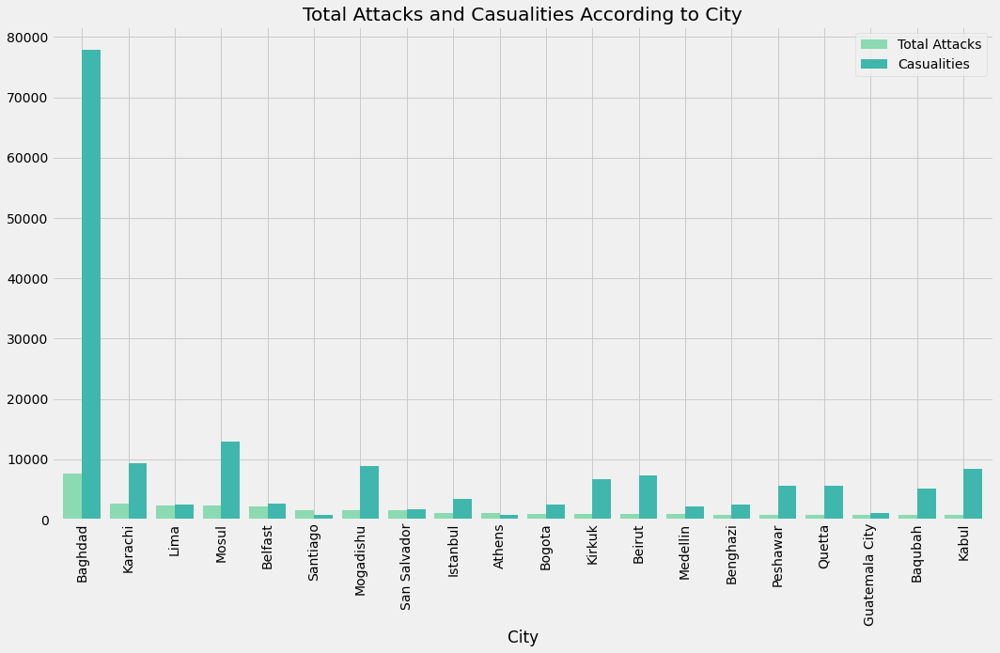

In [245]:
#display the graph of number of total attacks and victims based on each city
sns.set_palette('mako_r')
city_tot.plot.bar(x='City', width=0.8)
plt.xticks(rotation=90)
plt.title('Total Attacks and Casualities According to City')
fig = plt.gcf()
fig.set_size_inches(16,9)
plt.show()

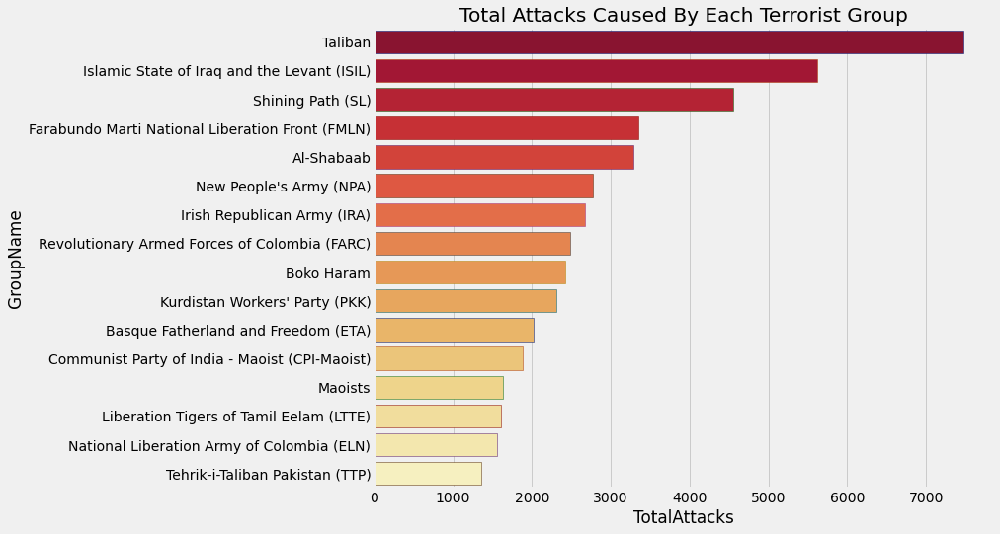

In [244]:
group_attacks = data.GroupName.value_counts().to_frame().drop('Unknown').reset_index()[:16]
group_attacks.columns = ['GroupName', 'TotalAttacks']
plt.subplots(figsize=(10,8))
sns.barplot(y=group_attacks['GroupName'], x=group_attacks['TotalAttacks'], palette='YlOrRd_r',
            edgecolor=sns.color_palette('dark', 10))
# plt.xticks()
plt.title('Total Attacks Caused By Each Terrorist Group')
plt.show()